<a href="https://colab.research.google.com/github/mrshamshir/WGAN-for-human-face-generation/blob/main/WGAN_for_face_generation_200k.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# importing the libraries
import torch, torchvision, os, PIL, pdb
from torch import nn
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt


In [2]:
def show(tensor, num=25, wandbactive=0, name=''):
  data = tensor.detach().cpu()
  grid = make_grid(data[:num], nrow=5).permute(1,2,0)

  ## optional
  if (wandbactive==1):
    wandb.log({name:wandb.Image(grid.numpy().clip(0,1))})

  plt.imshow(grid.clip(0,1))
  plt.show()

In [11]:
### hyperparameters and general parameters
n_epochs=4
batch_size=128
lr=1e-4
z_dim=200
device='cuda' #GPU

cur_step=0
crit_cycles=5
gen_losses=[]
crit_losses=[]
show_step=300
save_step=300

wandbact=0 # yes, we want to track stats through weights and biases, optional

In [ ]:
#### optional
!pip install wandb -qqq
import wandb
wandb.login(key='aec60f3a7953ced265a0065b116ad01846b483fe')  #instructions are in the related video :)
# wandb.login(key='PUT HERE YOUR WANDB KEY')  #instructions are in the related video :)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.4/196.4 kB 24.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 257.5/257.5 kB 31.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.6 MB/s eta 0:00:00


wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [ ]:
%%capture
experiment_name = wandb.util.generate_id()

myrun=wandb.init(
    project="wgan",
    group=experiment_name,
    config={
        "optimizer":"adam",
        "model":"wgan gp",
        "epoch":"1000",
        "batch_size":128
    }
)

config=wandb.config

## Sometimes this call to the wandb service may fail or give problems.
## If needed, you can use the Runtime->Restart Runtime option in the menus
## to restart and try again. If you keep having issues, you may set wandbact=0
## to skip temporarily the remote stats. You would also
## need to set wandbactive to 0 within the training loop in
## show(fake, wandbactive=0, name='fake') and show(real, wandbactive=0, name='real').
## However, in general this should work with no problems (try a few times if you have issues)

In [12]:
# generator model
# https://medium.com/@ideami

class Generator(nn.Module):
  def __init__(self, z_dim=64, d_dim=16):
    super(Generator, self).__init__()
    self.z_dim=z_dim

    self.gen = nn.Sequential(
            ## ConvTranspose2d: in_channels, out_channels, kernel_size, stride=1, padding=0
            ## Calculating new width and height: (n-1)*stride -2*padding +ks
            ## n = width or height
            ## ks = kernel size
            ## we begin with a 1x1 image with z_dim number of channels (200)
            nn.ConvTranspose2d(z_dim, d_dim * 32, 4, 1, 0), ## 4x4 (ch: 200, 512)
            nn.BatchNorm2d(d_dim*32),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*32, d_dim*16, 4, 2, 1), ## 8x8 (ch: 512, 256)
            nn.BatchNorm2d(d_dim*16),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*16, d_dim*8, 4, 2, 1), ## 16x16 (ch: 256, 128)
            #(n-1)*stride -2*padding +ks = (8-1)*2-2*1+4=16
            nn.BatchNorm2d(d_dim*8),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*8, d_dim*4, 4, 2, 1), ## 32x32 (ch: 128, 64)
            nn.BatchNorm2d(d_dim*4),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*4, d_dim*2, 4, 2, 1), ## 64x64 (ch: 64, 32)
            nn.BatchNorm2d(d_dim*2),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*2, 3, 4, 2, 1), ## 128x128 (ch: 32, 3)
            nn.Tanh() ### produce result in the range from -1 to 1
    )


  def forward(self, noise):
    x=noise.view(len(noise), self.z_dim, 1, 1)  # 128 x 200 x 1 x 1
    return self.gen(x)


def gen_noise(num, z_dim, device='cuda'):
   return torch.randn(num, z_dim, device=device) # 128 x 200



In [13]:
## critic model

class Critic(nn.Module):
  def __init__(self, d_dim=16):
    super(Critic, self).__init__()

    self.crit = nn.Sequential(
      # Conv2d: in_channels, out_channels, kernel_size, stride=1, padding=0
      ## New width and height: # (n+2*pad-ks)//stride +1
      nn.Conv2d(3, d_dim, 4, 2, 1), #(n+2*pad-ks)//stride +1 = (128+2*1-4)//2+1=64x64 (ch: 3,16)
      nn.InstanceNorm2d(d_dim),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim, d_dim*2, 4, 2, 1), ## 32x32 (ch: 16, 32)
      nn.InstanceNorm2d(d_dim*2),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*2, d_dim*4, 4, 2, 1), ## 16x16 (ch: 32, 64)
      nn.InstanceNorm2d(d_dim*4),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*4, d_dim*8, 4, 2, 1), ## 8x8 (ch: 64, 128)
      nn.InstanceNorm2d(d_dim*8),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*8, d_dim*16, 4, 2, 1), ## 4x4 (ch: 128, 256)
      nn.InstanceNorm2d(d_dim*16),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*16, 1, 4, 1, 0), #(n+2*pad-ks)//stride +1=(4+2*0-4)//1+1= 1X1 (ch: 256,1)

    )


  def forward(self, image):
    # image: 128 x 3 x 128 x 128
    crit_pred = self.crit(image) # 128 x 1 x 1 x 1
    return crit_pred.view(len(crit_pred),-1) ## 128 x 1


In [ ]:
## optional, init your weights in different ways
def init_weights(m):
    if isinstance(m, nn.Conv2d) or isinstance(m,nn.ConvTranspose2d):
      torch.nn.init.normal_(m.weight, 0.0, 0.02)
      torch.nn.init.constant_(m.bias,0)

    if isinstance(m,nn.BatchNorm2d):
      torch.nn.init.normal_(m.weight, 0.0, 0.02)
      torch.nn.init.constant_(m.bias,0)


##gen=gen.apply(init_weights)
##crit=crit.apply(init_weights)




In [6]:
# load dataset
import gdown, zipfile

url = 'https://drive.google.com/uc?id=0B7EVK8r0v71pZjFTYXZWM3FlRnM'
path='data/celeba'
download_path=f'{path}/img_align_celeba.zip'

if not os.path.exists(path):
  os.makedirs(path)

gdown.download(url, download_path, quiet=False)

with zipfile.ZipFile(download_path, 'r') as ziphandler:
  ziphandler.extractall(path)


#### Alternative download address:
# Celebra gdrive: https://drive.google.com/drive/folders/0B7EVK8r0v71pTUZsaXdaSnZBZzg?resourcekey=0-rJlzl934LzC-Xp28GeIBzQ
# Kaggle: https://www.kaggle.com/jessicali9530/celeba-dataset


Downloading...
From (original): https://drive.google.com/uc?id=0B7EVK8r0v71pZjFTYXZWM3FlRnM
From (redirected): https://drive.google.com/uc?id=0B7EVK8r0v71pZjFTYXZWM3FlRnM&confirm=t&uuid=08cfa7e8-8464-4f8d-b9e7-3db73a9679cc
To: /content/data/celeba/img_align_celeba.zip
100%|██████████| 1.44G/1.44G [00:19<00:00, 72.4MB/s]


data size is: 202599


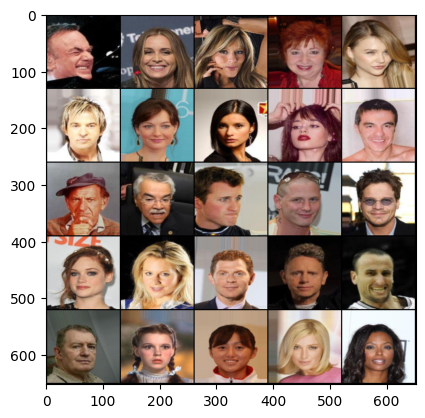

In [14]:
### Dataset, DataLoader, declare gen,crit, test dataset

class Dataset(Dataset):
  def __init__(self, path, size=128):
    self.sizes=[size, size]
    items, labels=[],[]

    for data in os.listdir(path):
      #path: './data/celeba/img_align_celeba'
      #data: '114568.jpg
      item = os.path.join(path,data)
      items.append(item)
      labels.append(data)
    print('data size is:', len(items))
    self.items=items
    self.labels=labels


  def __len__(self):
    return len(self.items)

  def __getitem__(self,idx):
    data = PIL.Image.open(self.items[idx]).convert('RGB') # (178,218)
    data = np.asarray(torchvision.transforms.Resize(self.sizes)(data)) # 128 x 128 x 3
    data = np.transpose(data, (2,0,1)).astype(np.float32, copy=False) # 3 x 128 x 128 # from 0 to 255
    data = torch.from_numpy(data).div(255) # from 0 to 1
    return data, self.labels[idx]

## Dataset
data_path='./data/celeba/img_align_celeba'
ds = Dataset(data_path, size=128)

## DataLoader
dataloader = DataLoader(ds, batch_size=batch_size, shuffle=True)

## Models
gen = Generator(z_dim).to(device)
crit = Critic().to(device)

## Optimizers
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(0.5,0.9))
crit_opt= torch.optim.Adam(crit.parameters(), lr=lr, betas=(0.5,0.9))

## Initializations
# gen=gen.apply(init_weights)
# crit=crit.apply(init_weights)

#wandb optional
if (wandbact==1):
  wandb.watch(gen, log_freq=100)
  wandb.watch(crit, log_freq=100)

x,y=next(iter(dataloader))
show(x)


In [15]:
## gradient penalty calculation

def get_gp(real, fake, crit, alpha, gamma=10):
  mix_images = real * alpha + fake * (1-alpha) # 128 x 3 x 128 x 128
  mix_scores = crit(mix_images) # 128 x 1

  gradient = torch.autograd.grad(
      inputs = mix_images,
      outputs = mix_scores,
      grad_outputs=torch.ones_like(mix_scores),
      retain_graph=True,
      create_graph=True,
  )[0] # 128 x 3 x 128 x 128

  gradient = gradient.view(len(gradient), -1)   # 128 x 49152
  gradient_norm = gradient.norm(2, dim=1)
  gp = gamma * ((gradient_norm-1)**2).mean()

  return gp



In [16]:
## Save and load checkpoints

root_path='/content/drive/MyDrive/output/exp3_ep10_200k/'

def save_checkpoint(name):
  torch.save({
      'epoch': epoch,
      'model_state_dict': gen.state_dict(),
      'optimizer_state_dict': gen_opt.state_dict()
  }, f"{root_path}G_{name}.pkl")

  torch.save({
      'epoch': epoch,
      'model_state_dict': crit.state_dict(),
      'optimizer_state_dict': crit_opt.state_dict()
  }, f"{root_path}C_{name}.pkl")

  print("Saved checkpoint")

def load_checkpoint(name):
  checkpoint = torch.load(f"{root_path}G_{name}.pkl")
  gen.load_state_dict(checkpoint['model_state_dict'])
  gen_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  checkpoint = torch.load(f"{root_path}C_{name}.pkl")
  crit.load_state_dict(checkpoint['model_state_dict'])
  crit_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  print("Loaded checkpoint")

#load_checkpoint('final-wgan-noinit')

In [ ]:
#!cp C-final* ./data/
#!cp G-final* ./data/
#epoch=1
#save_checkpoint("test")
#load_checkpoint("test")

  0%|          | 0/1583 [00:00<?, ?it/s]

Saving checkpoint:  300 300
Saved checkpoint


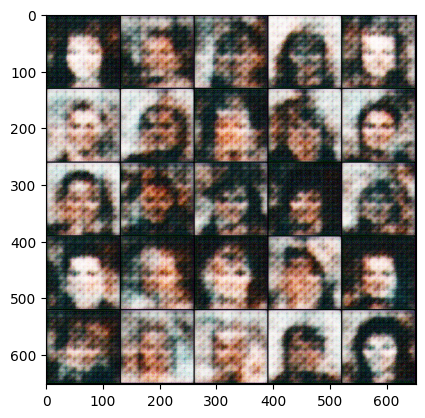

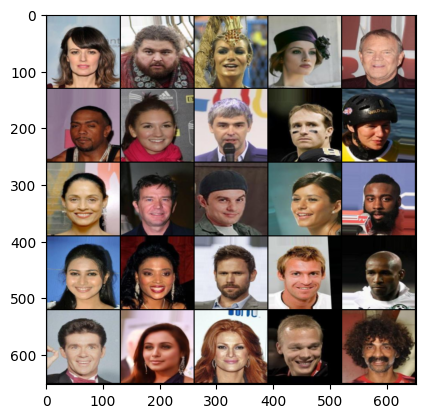

Epoch: 0: Step 300: Generator loss: 21.984552762756746, critic loss: -19.771674187819144
Saving checkpoint:  600 300
Saved checkpoint


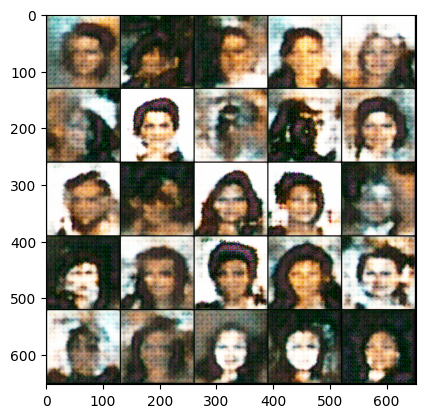

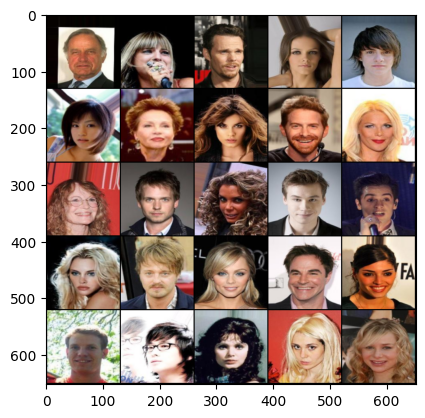

Epoch: 0: Step 600: Generator loss: 22.37967664718628, critic loss: -12.041323635419205
Saving checkpoint:  900 300
Saved checkpoint


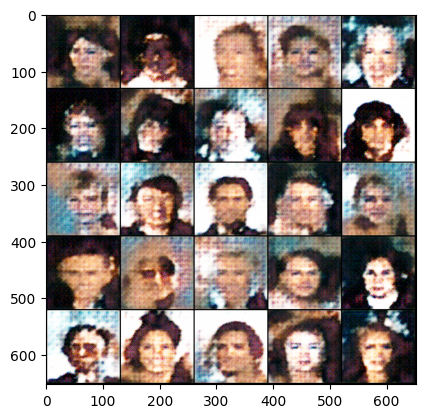

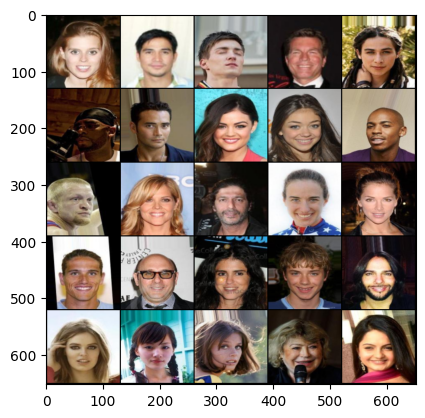

Epoch: 0: Step 900: Generator loss: 19.855630343755085, critic loss: -9.293999520619717
Saving checkpoint:  1200 300
Saved checkpoint


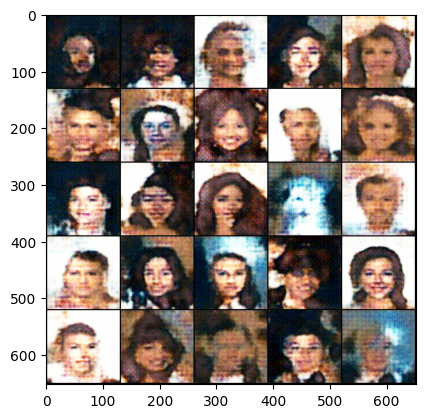

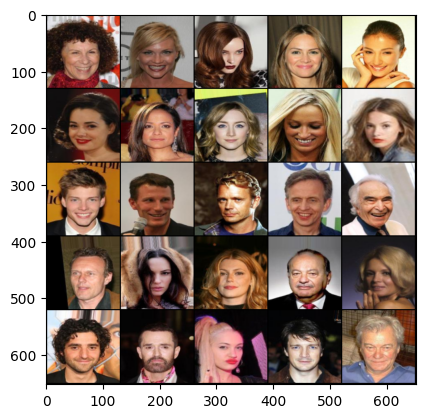

Epoch: 0: Step 1200: Generator loss: 18.57766450881958, critic loss: -8.292866397062934
Saving checkpoint:  1500 300
Saved checkpoint


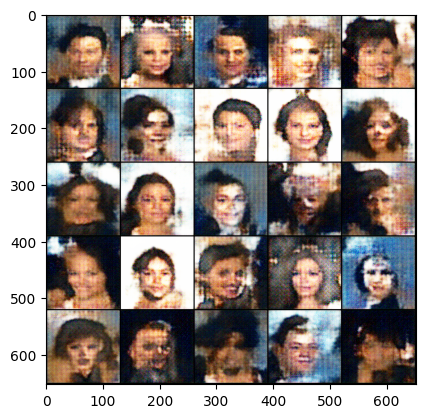

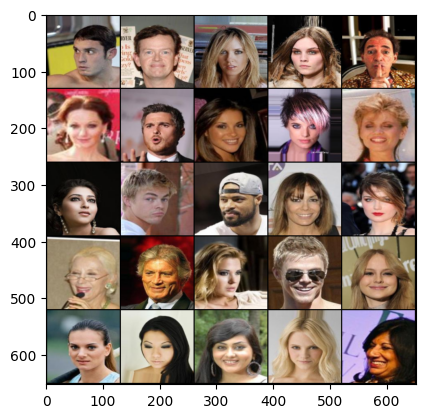

Epoch: 0: Step 1500: Generator loss: 17.489947592417398, critic loss: -7.411718046506242
Saving checkpoint:  1800 300
Saved checkpoint


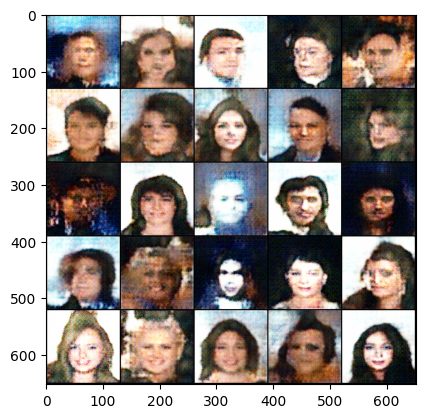

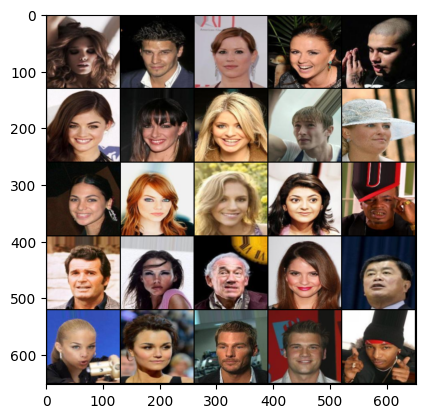

Epoch: 0: Step 1800: Generator loss: 16.713073765436807, critic loss: -6.724529128074651


  0%|          | 0/1583 [00:00<?, ?it/s]

Saving checkpoint:  2100 300
Saved checkpoint


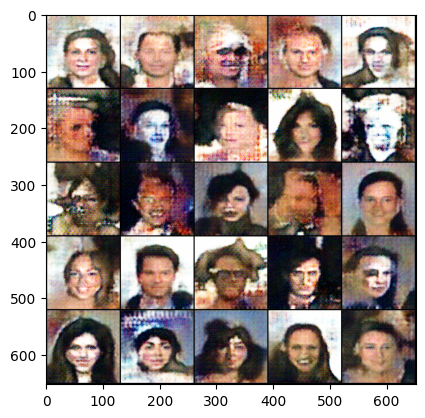

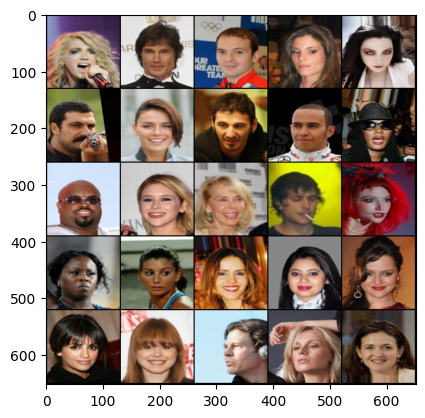

Epoch: 1: Step 2100: Generator loss: 15.65638987382253, critic loss: -6.208989631017048
Saving checkpoint:  2400 300
Saved checkpoint


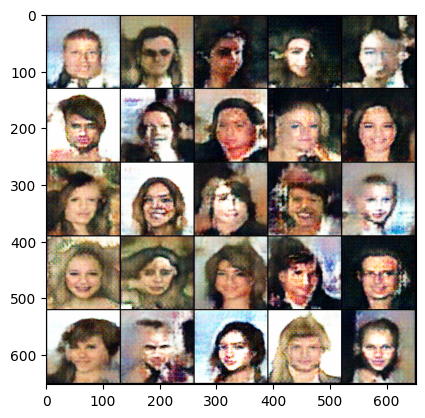

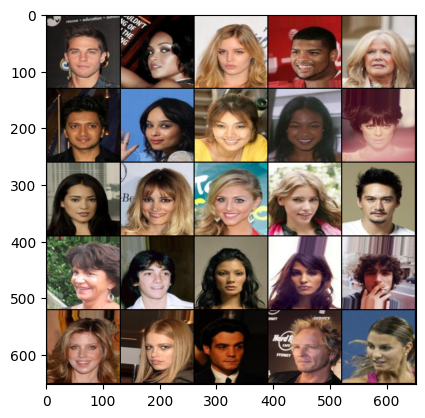

Epoch: 1: Step 2400: Generator loss: 14.25826166788737, critic loss: -5.738369834264121
Saving checkpoint:  2700 300
Saved checkpoint


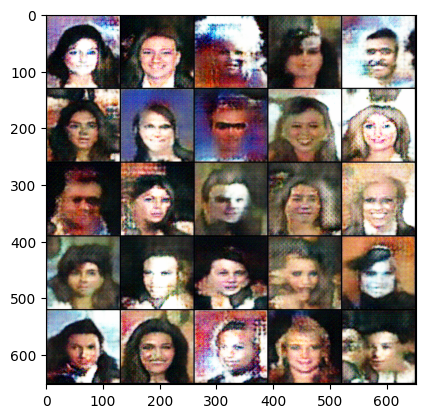

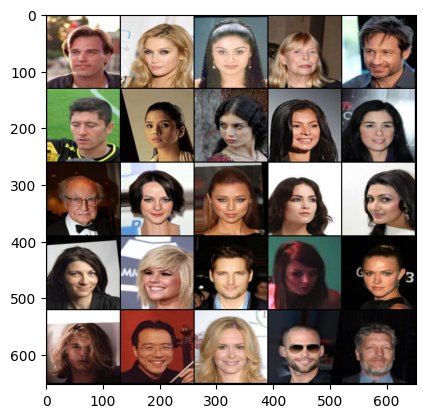

Epoch: 1: Step 2700: Generator loss: 12.547177329063416, critic loss: -5.4604582980473815
Saving checkpoint:  3000 300
Saved checkpoint


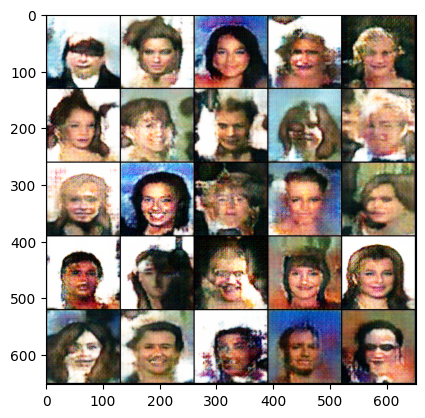

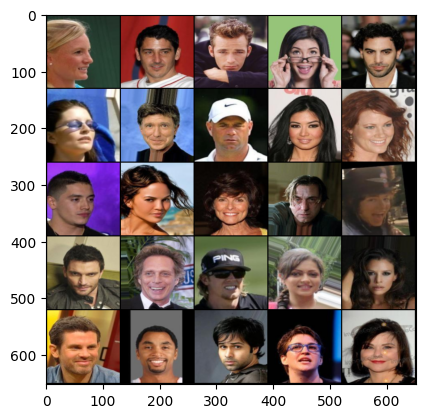

Epoch: 1: Step 3000: Generator loss: 11.58276575724284, critic loss: -5.200371992349621
Saving checkpoint:  3300 300
Saved checkpoint


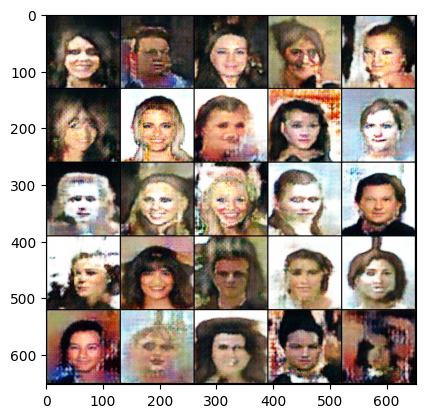

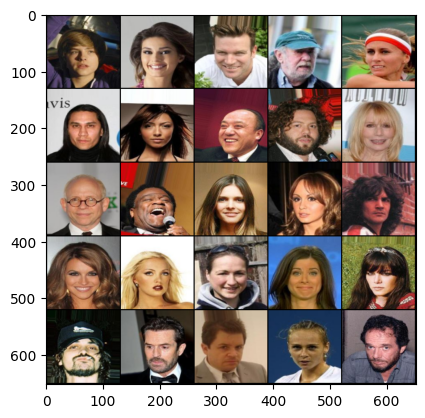

Epoch: 1: Step 3300: Generator loss: 10.953995286623638, critic loss: -4.907392005364099


  0%|          | 0/1583 [00:00<?, ?it/s]

Saving checkpoint:  3600 300
Saved checkpoint


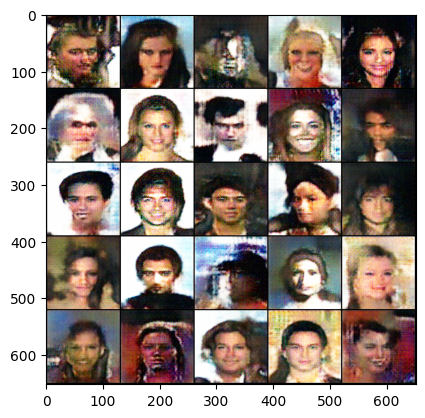

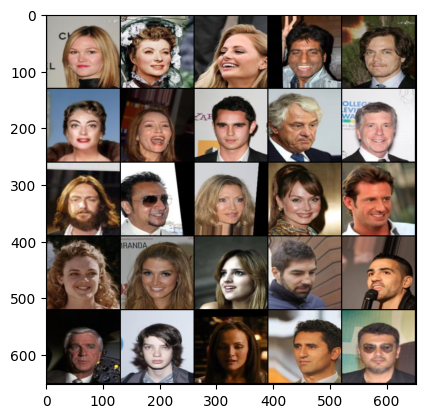

Epoch: 2: Step 3600: Generator loss: 10.387182832558949, critic loss: -4.739582185188929
Saving checkpoint:  3900 300
Saved checkpoint


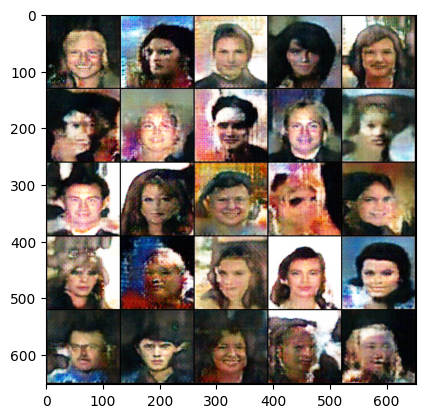

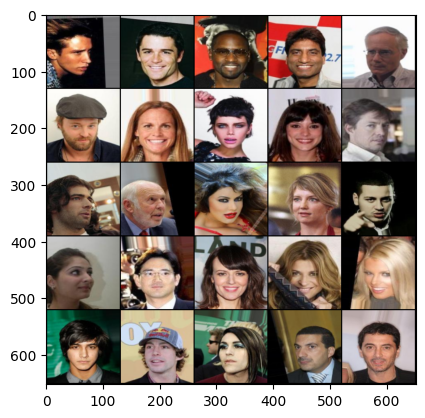

Epoch: 2: Step 3900: Generator loss: 9.343643420934677, critic loss: -4.586548597455026
Saving checkpoint:  4200 300
Saved checkpoint


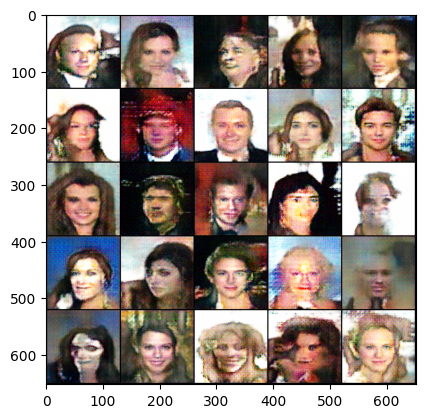

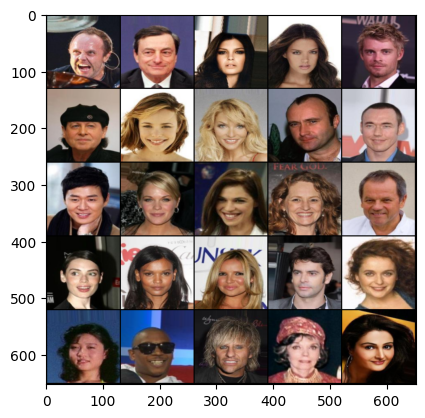

Epoch: 2: Step 4200: Generator loss: 8.334918730656305, critic loss: -4.416684743682544
Saving checkpoint:  4500 300
Saved checkpoint


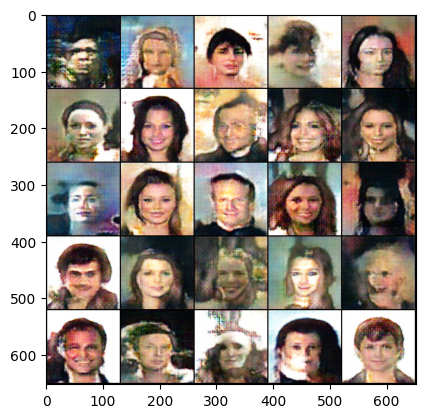

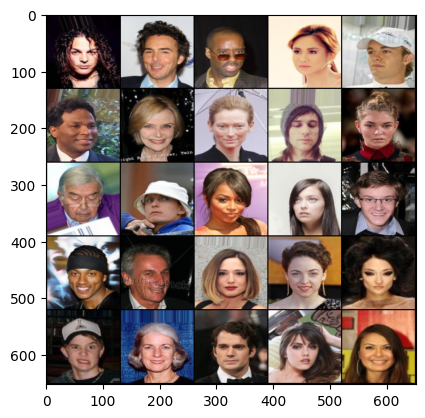

Epoch: 2: Step 4500: Generator loss: 7.050287403861682, critic loss: -4.182425697525338
Saving checkpoint:  4800 300
Saved checkpoint


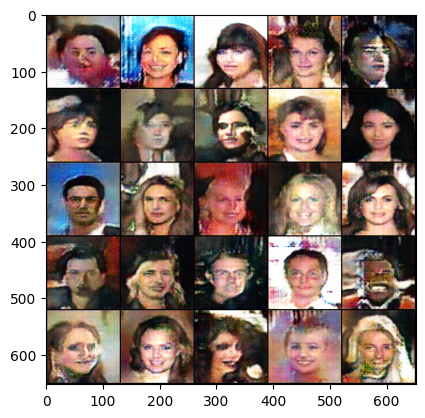

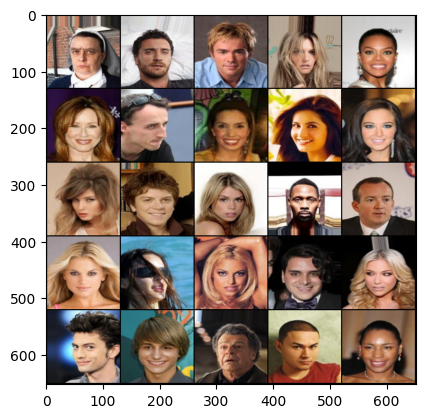

Epoch: 2: Step 4800: Generator loss: 6.281924991806348, critic loss: -4.071124534686402


  0%|          | 0/1583 [00:00<?, ?it/s]

Saving checkpoint:  5100 300
Saved checkpoint


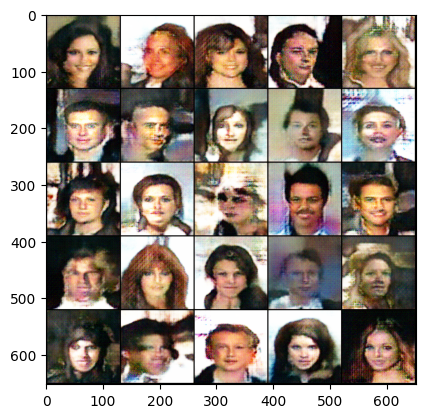

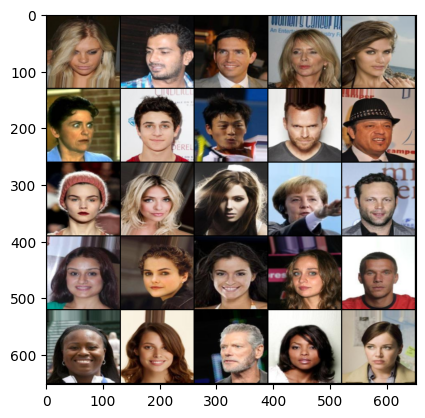

Epoch: 3: Step 5100: Generator loss: 5.334174755265315, critic loss: -3.9634014976421965
Saving checkpoint:  5400 300
Saved checkpoint


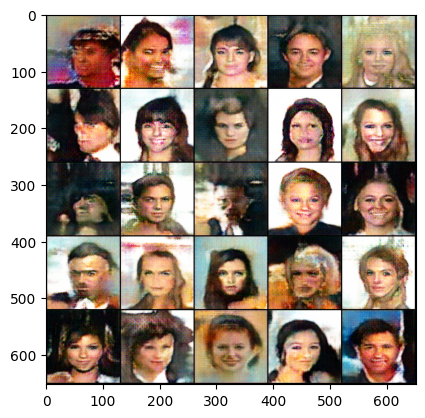

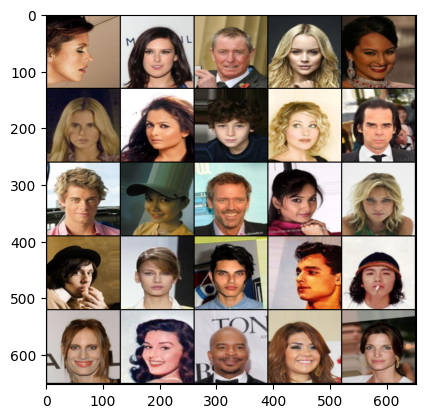

Epoch: 3: Step 5400: Generator loss: 4.8418195921679335, critic loss: -3.909307922979197
Saving checkpoint:  5700 300
Saved checkpoint


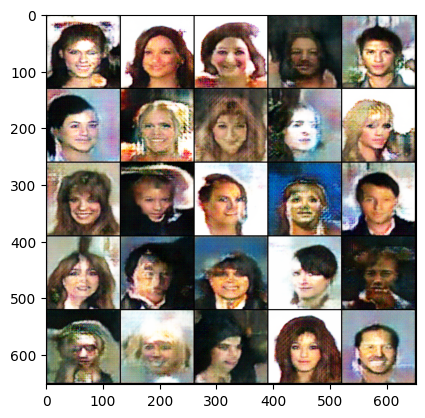

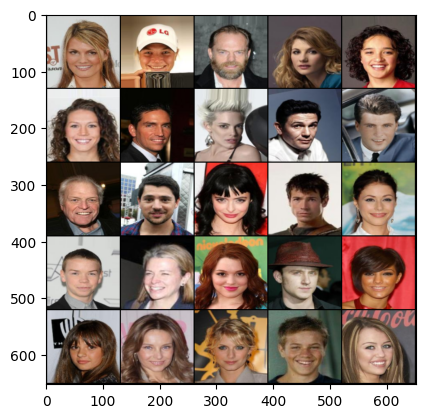

Epoch: 3: Step 5700: Generator loss: 4.354627643227577, critic loss: -3.8066343700091054
Saving checkpoint:  6000 300
Saved checkpoint


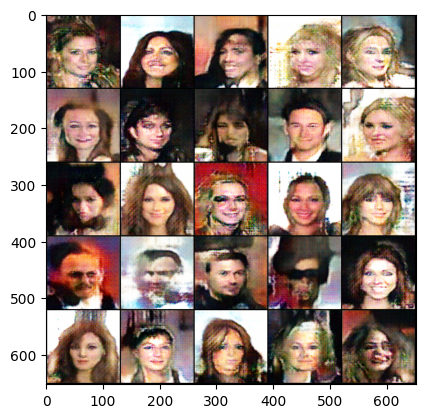

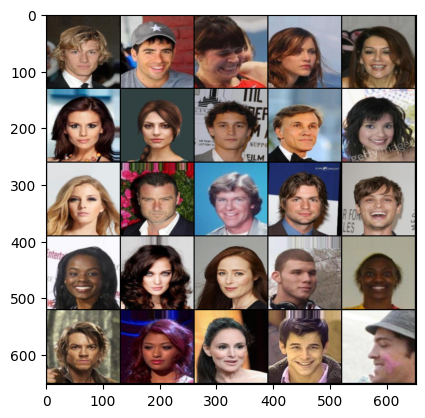

Epoch: 3: Step 6000: Generator loss: 3.2617103696117797, critic loss: -3.6563162421782827
Saving checkpoint:  6300 300
Saved checkpoint


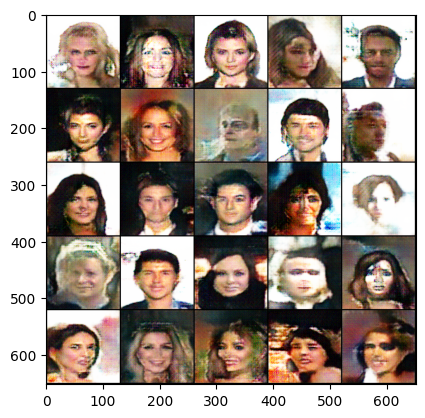

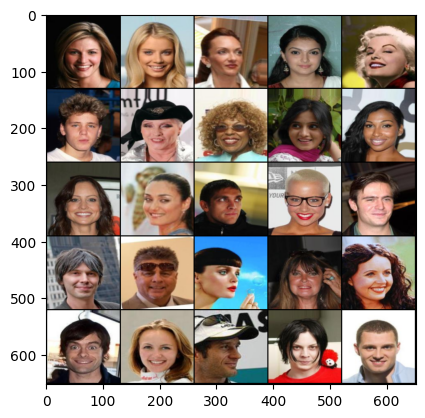

Epoch: 3: Step 6300: Generator loss: 3.0965016660715143, critic loss: -3.564029567281405
Saving checkpoint:  6600 300
Saved checkpoint


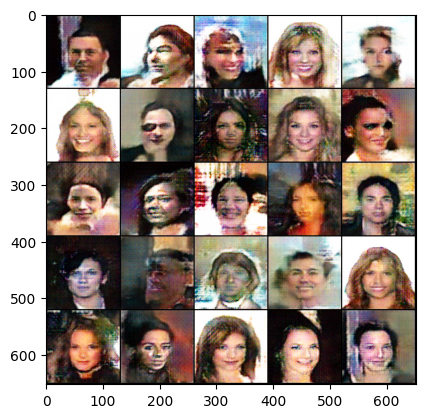

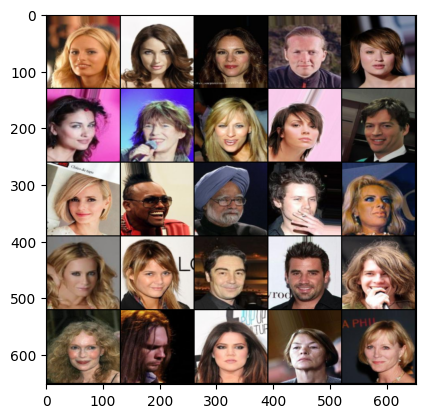

Epoch: 3: Step 6600: Generator loss: 2.0653187812119724, critic loss: -3.460733218073845


In [18]:
## Training loop

for epoch in range(n_epochs):
  for real, _ in tqdm(dataloader):
    cur_bs= len(real) #128
    real=real.to(device)

    ### CRITIC
    mean_crit_loss = 0
    for _ in range(crit_cycles):
      crit_opt.zero_grad()

      noise=gen_noise(cur_bs, z_dim, device)
      fake = gen(noise)
      crit_fake_pred = crit(fake.detach())
      crit_real_pred = crit(real)

      alpha=torch.rand(len(real),1,1,1,device=device, requires_grad=True) # 128 x 1 x 1 x 1
      gp = get_gp(real, fake.detach(), crit, alpha)

      crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + gp

      mean_crit_loss+=crit_loss.item() / crit_cycles

      crit_loss.backward(retain_graph=True)
      crit_opt.step()

    crit_losses+=[mean_crit_loss]

    ### GENERATOR
    gen_opt.zero_grad()
    noise = gen_noise(cur_bs, z_dim, device)
    fake = gen(noise)
    crit_fake_pred = crit(fake)

    gen_loss = -crit_fake_pred.mean()
    gen_loss.backward()
    gen_opt.step()

    gen_losses+=[gen_loss.item()]

    ### Stats

    if (wandbact==1):
      wandb.log({'Epoch': epoch, 'Step': cur_step, 'Critic loss':mean_crit_loss, 'Gen loss': gen_loss})

    if cur_step % save_step == 0 and cur_step > 0:
      print("Saving checkpoint: ", cur_step, save_step)
      save_checkpoint(f"epoch{epoch}_step{cur_step}")

    if (cur_step % show_step == 0 and cur_step > 0):
      show(fake, wandbactive=0, name='fake')
      show(real, wandbactive=0, name='real')

      gen_mean=sum(gen_losses[-show_step:]) / show_step
      crit_mean = sum(crit_losses[-show_step:]) / show_step
      print(f"Epoch: {epoch}: Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")

    #   if (cur_step % (show_step*5) == 0 and cur_step > 0):
    #     plt.plot(
    #         range(len(gen_losses)),
    #         torch.Tensor(gen_losses),
    #         label="Generator Loss"
    #     )

    #     plt.plot(
    #         range(len(gen_losses)),
    #         torch.Tensor(crit_losses),
    #         label="Critic Loss"
    #     )

    #     plt.ylim(-150,150)
    #     plt.legend()
    #     plt.show()

    cur_step+=1


In [ ]:
# number of steps per epoch
# 10000 / 128 = 78.125
# 50000 / 128 = 390.625
# 202599 / 128 = 1582.8

In [19]:
save_checkpoint(f"epoch{epoch}_step{cur_step}")

Saved checkpoint


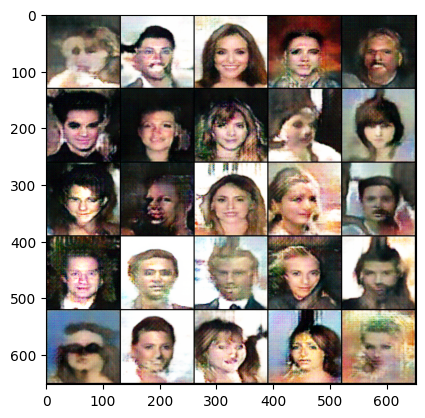

In [22]:
#### Generate new faces
noise = gen_noise(batch_size, z_dim, device)
fake = gen(noise)
show(fake)

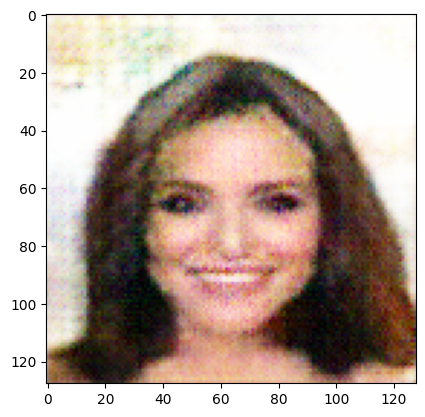

In [24]:
plt.imshow(fake[2].detach().cpu().permute(1,2,0).squeeze().clip(0,1))

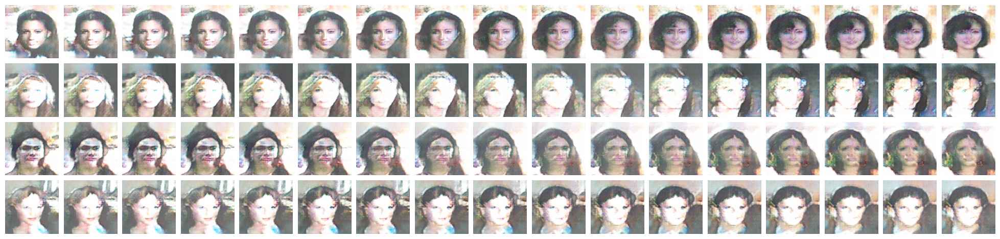

In [26]:
from mpl_toolkits.axes_grid1 import ImageGrid

# MORPHING, interpolation between points in latent space
gen_set=[]
z_shape=[1,200,1,1]
rows=4
steps=17

for i in range(rows):
  z1,z2 = torch.randn(z_shape), torch.randn(z_shape)
  for alpha in np.linspace(0,1,steps):
    z=alpha*z1 + (1-alpha)*z2
    res=gen(z.cuda())[0]
    gen_set.append(res)

fig = plt.figure(figsize=(25,11))
grid=ImageGrid(fig, 111, nrows_ncols=(rows,steps), axes_pad=0.1)

for ax , img in zip (grid, gen_set):
  ax.axis('off')
  res=img.cpu().detach().permute(1,2,0)
  res=res-res.min()
  res=res/(res.max()-res.min())
  ax.imshow(res.clip(0,1.0))

plt.show()